In [1]:
!nvidia-smi

Mon Jun  8 15:41:39 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.64.00    Driver Version: 440.64.00    CUDA Version: 10.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  GeForce GTX 980     On   | 00000000:01:00.0 Off |                  N/A |
| 41%   72C    P2   110W / 180W |   3990MiB /  4043MiB |     93%      Default |
+-------------------------------+----------------------+----------------------+
|   1  Quadro K2200        On   | 00000000:05:00.0 Off |                  N/A |
| 43%   47C    P8     1W /  39W |      1MiB /  4041MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
        

In [8]:
import numpy as np
import os
os.environ['TF_KERAS'] = '1'
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

In [16]:
import tensorflow as tf
import segmentation_models as sm
from tensorflow.keras import callbacks
from keras_radam import RAdam

import albumentations as albu

import cv2
import matplotlib.pyplot as plt
import pandas as pd

/home/arsh/miniconda3/envs/gamescore_extraction/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)


In [4]:
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [5]:
sm.set_framework('tf.keras')

BACKBONE = 'resnet50'
BATCH_SIZE = 8

In [6]:
root_path = '.'
checkpoints_path = f'{root_path}/checkpoints'

In [7]:
num_classes = 20

## Colors

In [8]:
import scipy.io
mat = scipy.io.loadmat(f'{root_path}/human_colormap.mat')
color_map = (mat['colormap'] * 256).astype(np.int32)

In [9]:
color_classes_map = {
    0: 'Background',
    1: 'Hat',
    2: 'Hair',
    3: 'Glove',
    4: 'Sunglasses',
    5: 'UpperClothes',
    6: 'Dress',
    7: 'Coat',
    8: 'Socks',
    9: 'Pants',
    10: 'Torso-skin',
    11: 'Scarf',
    12: 'Skirt',
    13: 'Face',
    14: 'Left-arm ',
    15: 'Right-arm',
    16: 'Left-leg',
    17: 'Right-leg',
    18: 'Left-shoe',
    19: 'Right-shoe',
}

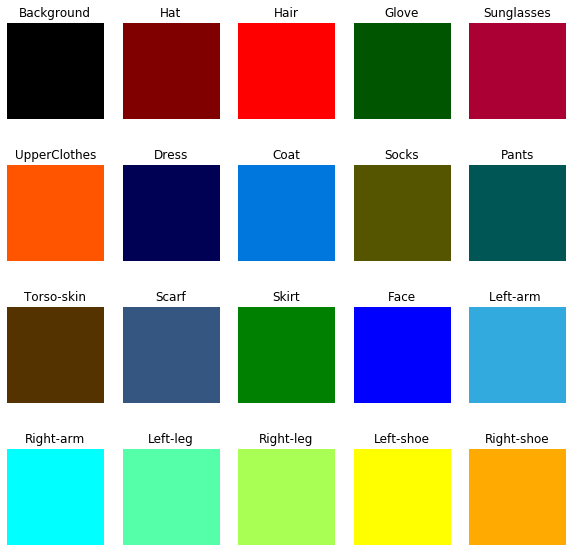

In [10]:
fig, axes = plt.subplots(4,5, figsize=(10,10))
ax = axes.flatten()
[axi.set_axis_off() for axi in ax]

for i,c in enumerate(color_map):
    color = np.dstack((np.ones((255,255))*c[0],np.ones((255,255))*c[1],np.ones((255,255))*c[2])).astype(np.uint8)
    ax[i].imshow(color)
    ax[i].set_title(color_classes_map[i])

## Data Generator

In [11]:
from tensorflow.python.keras.utils.data_utils import Sequence
from keras.utils import to_categorical

In [12]:
dataset_path = '/work/develop/datasets/LIP/CIHP/instance-level_human_parsing'

train_images_path = f'{dataset_path}/Training/Images'
train_id_path = f'{dataset_path}/Training/train_id.txt' #-6866
train_categories_path = f'{dataset_path}/Training/Category_ids'

valid_images_path = f'{dataset_path}/Validation/Images'
valid_categories_path = f'{dataset_path}/Validation/Category_ids'
valid_id_path = f'{dataset_path}/Validation/val_id.txt'

In [14]:
def get_preprocessing(preprocessing_fn):
    _transform = [
        albu.Lambda(image=preprocessing_fn),
    ]
    
    return albu.Compose(_transform)

def get_train_augmentations():
    _transform = [
        # albu.VerticalFlip(), 
        albu.HorizontalFlip(), 
        albu.ShiftScaleRotate(scale_limit=0.1, rotate_limit=10, shift_limit=0.1, border_mode=0), 
        albu.RandomBrightnessContrast(),
        # albu.GridDistortion(num_steps=2),
#         albu.Blur(blur_limit=3)
    ]
    
    return albu.Compose(_transform, p=0.5)  # probabilty of tranformation

In [14]:
class DataGenerator(Sequence):
    def __init__(self, usage, batch_size, num_classes, preprocessing=None, augmentation=None):
        self.usage = usage

        if usage == 'train':
            id_file = train_id_path
            self.images_folder = train_images_path
            self.categories_folder = train_categories_path
        else:
            id_file = valid_id_path
            self.images_folder = valid_images_path
            self.categories_folder = valid_categories_path
            
        self.batch_size = batch_size
        self.num_classes = num_classes
        self.preprocessing = preprocessing
        self.augmentation = augmentation
        
        with open(id_file, 'r') as f:
            self.names = f.read().splitlines()

        np.random.shuffle(self.names)

    def __len__(self):
        return int(np.ceil(len(self.names) / float(self.batch_size)))

    def __getitem__(self, idx):
        i = idx * self.batch_size
        
        img_rows, img_cols = 224, 224

        length = min(self.batch_size, (len(self.names) - i))
        batch_x = np.empty((length, img_rows, img_cols, 3), dtype=np.float32)
        batch_y = np.empty((length, img_rows, img_cols, self.num_classes), dtype=np.float32)

        for i_batch in range(length):
            name = self.names[i]
            filename = os.path.join(self.images_folder, name + '.jpg')
            image = cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2RGB)
            image_size = image.shape[:2]
            category = self.__get_category(self.categories_folder, name)

            image = cv2.resize(image, (img_rows, img_cols))
            category = cv2.resize(category, (img_rows, img_cols))
        
            if self.augmentation:
                augmented = self.augmentation(image=image, mask=category)
                image = augmented['image']
                category = augmented['mask']
        
            if self.preprocessing:
                preprocessed = self.preprocessing(image=image)
                image = preprocessed['image']

            batch_x[i_batch, :, :, 0:3] = image
            batch_y[i_batch, :, :] = to_categorical(category, self.num_classes)

            i += 1

        return batch_x, batch_y
    
    def __get_category(self, categories_folder, name):
        filename = os.path.join(categories_folder, name + '.png')
        semantic = cv2.imread(filename, 0)
        return semantic

    def on_epoch_end(self):
        np.random.shuffle(self.names)

In [15]:
preprocess_input = sm.get_preprocessing(BACKBONE)

data_generator_valid = DataGenerator('valid', BATCH_SIZE, num_classes, get_preprocessing(preprocess_input))

In [16]:
# for i in range(3535):
#     data_generator_valid[i]

## Preview

In [17]:
def merge_masks(masks, num_classes):
    res = np.zeros((masks.shape[0], masks.shape[1], num_classes), dtype=np.uint8)
    for c in range(num_classes):
        res[:,:,c] = c*masks[:,:,c]
    return np.sum(res, axis=-1)

def merge_masks_vis(masks, num_classes, color_map):
    res = np.zeros((masks.shape[0], masks.shape[1], 3), dtype=np.uint8)

    for r in range(masks.shape[0]):
        for c in range(masks.shape[1]):
            color_id = np.argmax(masks[r,c,:])
            res[r, c, :] = color_map[color_id]
            
    return res.astype(np.uint8)

def preview_image(image):
    a_old = np.min(image)
    b_old = np.max(image)
    
    a_new = 0
    b_new = 255

    y = (b_old - a_old)/(b_new - a_new)
    x = a_new*y - a_old
    return ((image + x)/y).astype(np.uint8)

In [18]:
xs,ys = data_generator_valid[0]
print(xs.shape, ys.shape)
print(np.unique(ys, return_counts=True))

(8, 224, 224, 3) (8, 224, 224, 20)
(array([0., 1.], dtype=float32), array([7626752,  401408]))


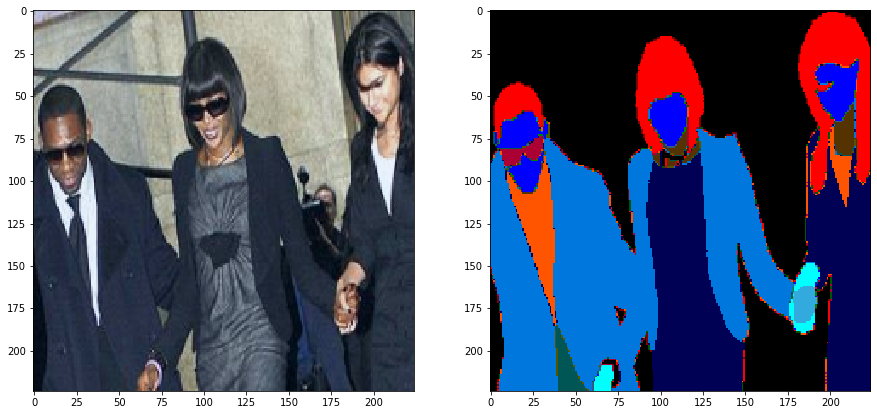

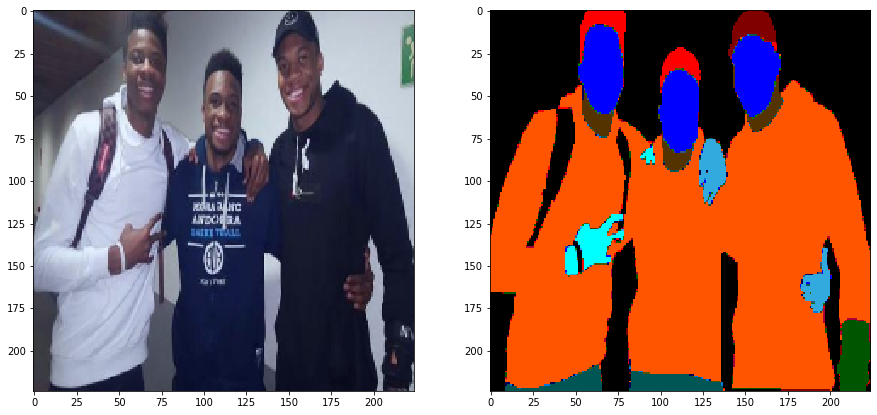

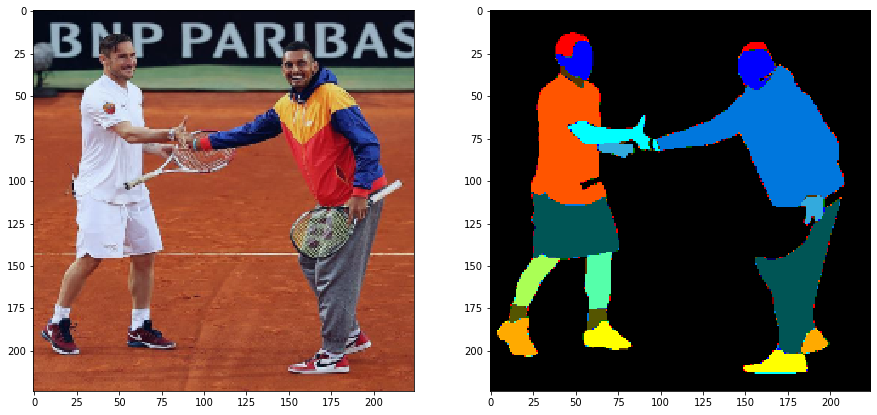

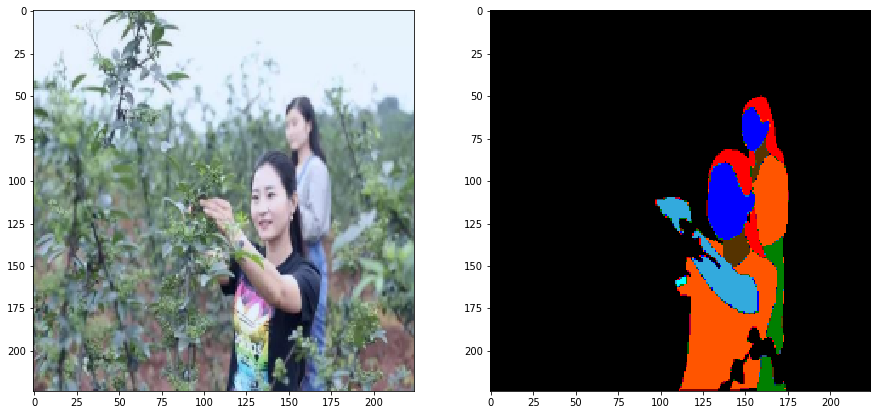

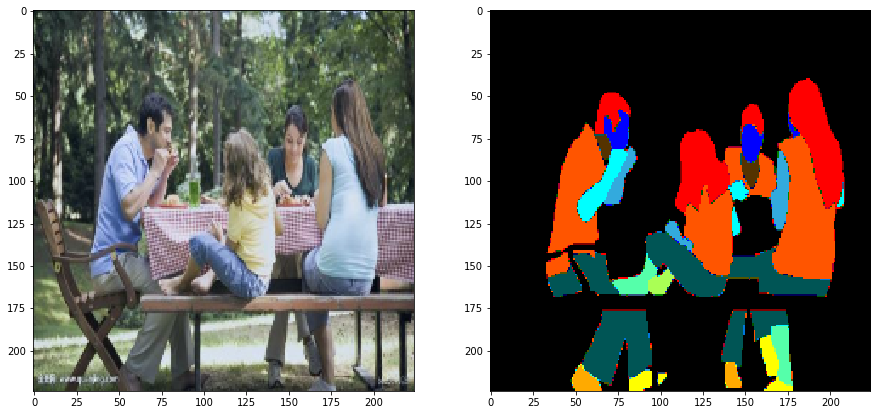

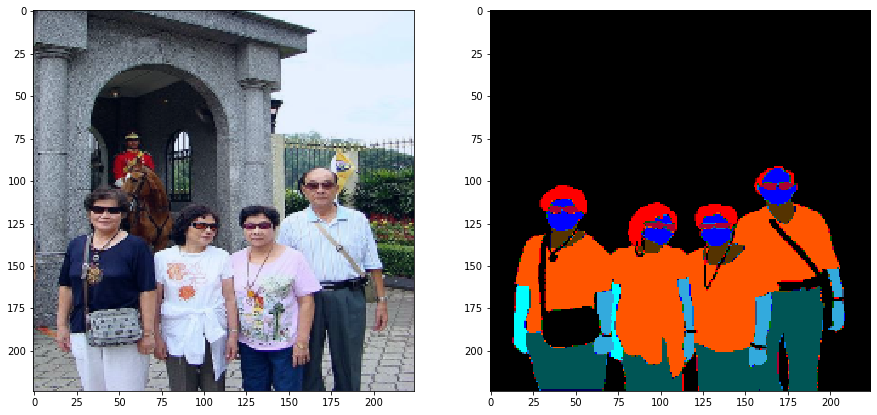

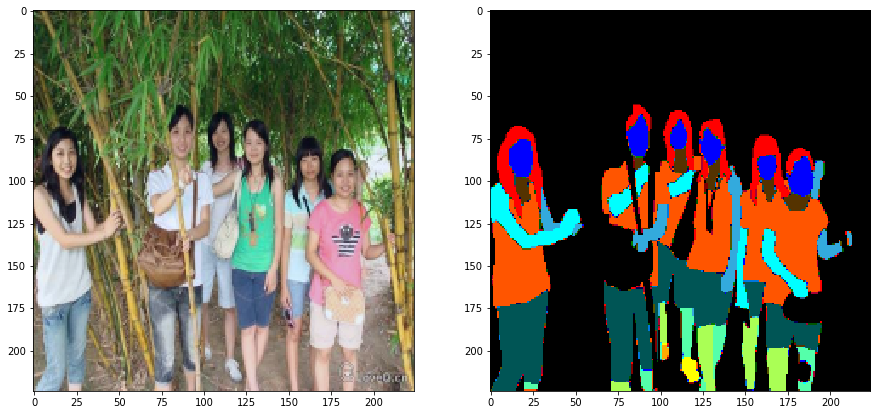

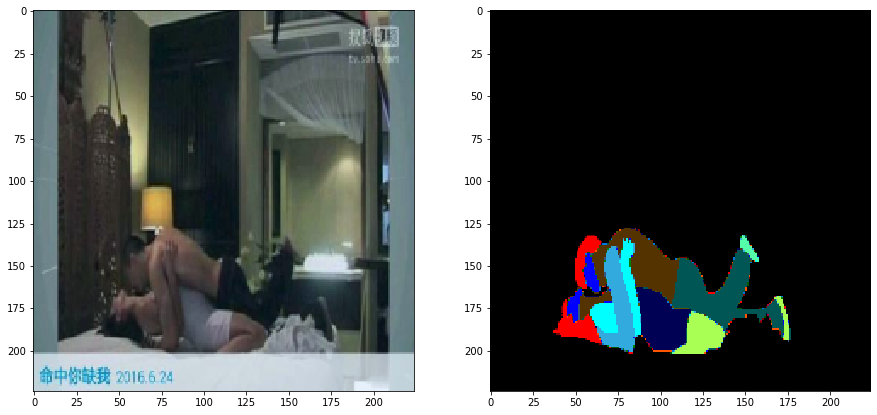

In [19]:
for i in range(BATCH_SIZE):
    fig, ax = plt.subplots(1, 2, figsize=(15, 15))
    axes = ax.flat
    axes[0].imshow(preview_image(xs[i]))
    parse = merge_masks_vis(ys[i], num_classes, color_map)
    axes[1].imshow(parse, cmap='gray')

## Eval

In [20]:
def mean_iou(gt, pred):
    num_classes = gt.shape[-1]
    iou = np.zeros((num_classes))
    
    for c in range(num_classes):
        intersection = np.sum(gt[:,:,c] * pred[:,:,c])
        union = np.sum(gt[:,:,c] + pred[:,:,c]) - intersection
        if intersection != 0 or union != 0:
            iou[c] = intersection/union
        else:
            iou[c] = 1 # class is not presented
        
    return np.mean(iou), iou

def iou_by_class(iou, color_classes_map):
    num_classes = len(color_classes_map)
    
    return [f'{color_classes_map[i]}: {iou[i]:0.4f}' for i in range(num_classes)]

In [54]:
threshold = 0.5

In [55]:
def evaluate_model(model, data_generator_valid, threshold):
    evaluation = []
    for i in range(len(data_generator_valid)):
        val_xs,val_ys = data_generator_valid[i]
        prediction = model.predict(val_xs)
        prediction = (prediction > threshold).astype(np.uint8)
        for j in range(data_generator_valid.batch_size):
            miou, iou = mean_iou(val_ys[j], prediction[j])
            evaluation.append([*iou, miou])

    return pd.DataFrame(evaluation, columns=[*color_classes_map.values(), 'Mean IoU'])

In [56]:
eval_models_result = dict()
for weights_name in os.listdir(checkpoints_path):
    if os.path.isfile(f'{checkpoints_path}/{weights_name}'):
        model = sm.Unet(BACKBONE, input_shape=(224, 224, 3), classes=num_classes, activation='sigmoid', encoder_weights='imagenet')
        model.load_weights(f'{checkpoints_path}/{weights_name}')
        eval_pd = evaluate_model(model, data_generator_valid, threshold)
        miou = eval_pd['Mean IoU'].mean()
        eval_models_result[weights_name] = {'eval_pd': eval_pd, 'mean_iou': miou}
        print(f'{weights_name}: {miou:0.4f}')

202006080633_0.0005_iou_val_weights.hdf5: 0.3842
202006072038_0.001_loss_val_weights.hdf5: 0.3856
202006072038_0.001_iou_val_weights.hdf5: 0.3863
202006080858_0.001_iou_val_weights.hdf5: 0.3823
202006081528_0.001_iou_val_weights.hdf5: 0.3798
202006081528_0.001_loss_val_weights.hdf5: 0.3798
202006081528_0.001_loss_train_weights.hdf5: 0.3806
202006081311_0.001_iou_val_weights.hdf5: 0.3828
202006071521_0.001_loss_val_weights.hdf5: 0.3859
202006081528_0.001_iou_train_weights.hdf5: 0.3806
202006071521_0.001_iou_val_weights.hdf5: 0.3867
202006081058_0.001_loss_val_weights.hdf5: 0.3825
202006071933_0.001_loss_val_weights.hdf5: 0.3828
202006081311_0.001_loss_val_weights.hdf5: 0.3828
202006071933_0.001_iou_val_weights.hdf5: 0.3828
202006081058_0.001_iou_val_weights.hdf5: 0.3825
202006080858_0.001_loss_val_weights.hdf5: 0.3823
202006080633_0.0005_loss_val_weights.hdf5: 0.3845


In [57]:
weights_name = '202006072038_0.001_iou_val_weights.hdf5'

In [58]:
eval_models_result[weights_name]['eval_pd']

,Background,Hat,Hair,Glove,Sunglasses,UpperClothes,Dress,Coat,Socks,Pants,...,Scarf,Skirt,Face,Left-arm,Right-arm,Left-leg,Right-leg,Left-shoe,Right-shoe,Mean IoU
0,0.919915,0.000000,0.784608,0.035623,0.245050,0.699579,0.452877,0.687525,0.024000,0.203931,...,0.097701,0.0,0.729260,0.002545,0.380880,1.000000,1.000000,1.000000,1.000000,0.493359
1,0.845121,0.612416,0.541469,0.037956,0.072243,0.920608,0.000000,0.002088,0.057377,0.586359,...,0.076503,0.0,0.921601,0.712514,0.742902,1.000000,1.000000,1.000000,1.000000,0.544369
2,0.971554,0.000000,0.574194,0.034884,0.074286,0.877228,0.000000,0.934016,0.669201,0.891929,...,0.058824,0.0,0.851904,0.241715,0.496025,0.496925,0.435279,0.554358,0.338649,0.446169
3,0.977054,0.000000,0.728889,0.044025,0.000000,0.686488,0.000000,0.000000,0.000000,0.000000,...,0.060606,0.0,0.898526,0.593333,0.000000,1.000000,1.000000,1.000000,1.000000,0.435602
4,0.950622,0.000000,0.856171,0.056213,0.090129,0.875478,0.000000,0.000000,0.000000,0.748445,...,0.035714,0.0,0.758000,0.398496,0.567465,0.453435,0.030534,0.317021,0.158273,0.348077
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,0.836913,0.000000,0.760673,0.032727,0.049107,0.006584,0.000000,0.000000,0.000000,0.617067,...,0.000000,0.0,0.164491,0.048583,0.000000,0.000000,0.000000,0.000000,0.000000,0.142281
4996,0.933999,0.000000,0.602435,0.011111,0.042216,0.876040,0.000000,0.000000,0.033058,0.008382,...,0.070496,0.0,0.780634,0.159822,0.400208,1.000000,1.000000,1.000000,1.000000,0.416174
4997,0.977915,0.362222,0.000000,0.000000,0.023810,0.000000,0.000000,0.607323,0.000000,0.010799,...,0.000000,0.0,0.216216,0.000000,0.000000,0.000000,0.000000,0.000000,0.697183,0.144773
4998,0.930225,0.005917,0.720317,0.034286,0.008403,0.093567,0.000000,0.306980,0.000000,0.002848,...,0.055130,0.0,0.859939,0.296754,0.026144,0.000000,1.000000,1.000000,1.000000,0.317025


In [59]:
eval_models_result[weights_name]['eval_pd'].mean().sort_values(ascending=False)

Background      0.904983
Face            0.746888
Right-shoe      0.705399
Left-shoe       0.695494
Hair            0.616662
Left-leg        0.603481
Right-leg       0.603161
Torso-skin      0.500336
UpperClothes    0.487290
Right-arm       0.427439
Pants           0.398716
Left-arm        0.387619
Mean IoU        0.386254
Coat            0.250064
Hat             0.123309
Dress           0.085780
Sunglasses      0.049405
Scarf           0.040659
Glove           0.039754
Socks           0.036841
Skirt           0.021804
dtype: float64

In [60]:
model = sm.Unet(BACKBONE, input_shape=(224, 224, 3), classes=num_classes, activation='softmax', encoder_weights='imagenet')
model.load_weights(f'{checkpoints_path}/{weights_name}')
val_xs,val_ys = data_generator_valid[0]
prediction = model.predict(val_xs)
prediction = (prediction > threshold).astype(np.uint8)
val_ys.shape, prediction.shape

((8, 224, 224, 20), (8, 224, 224, 20))

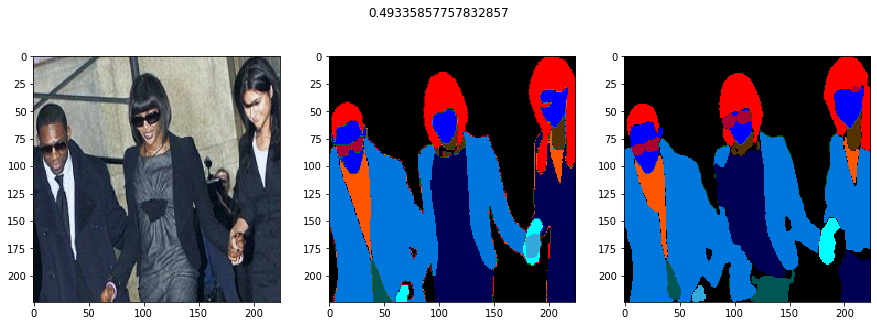

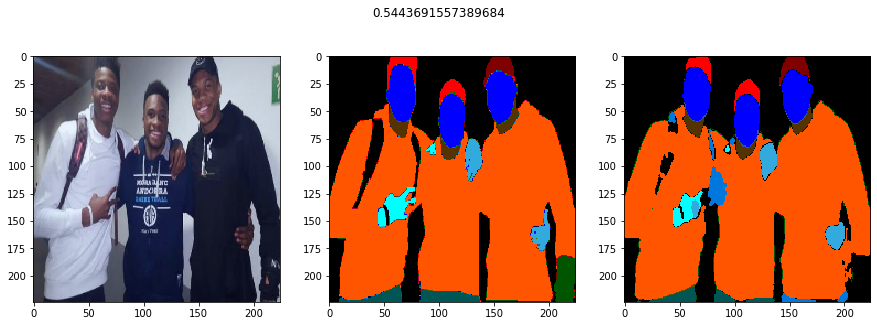

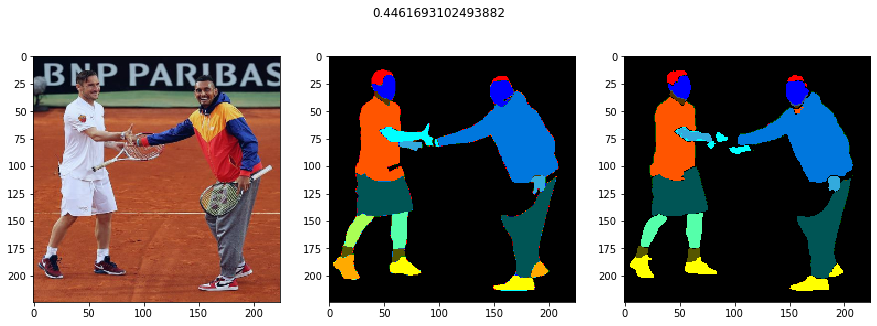

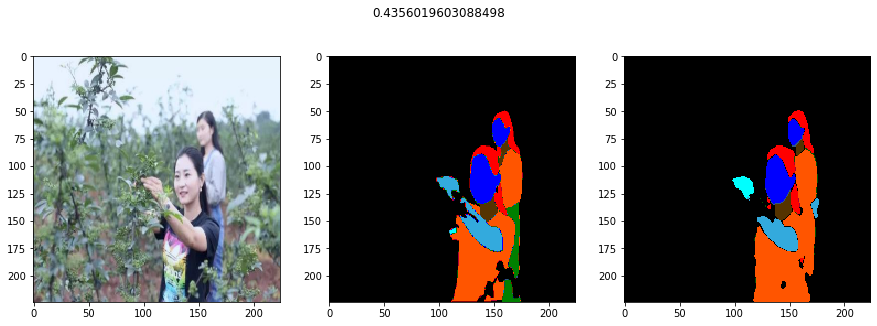

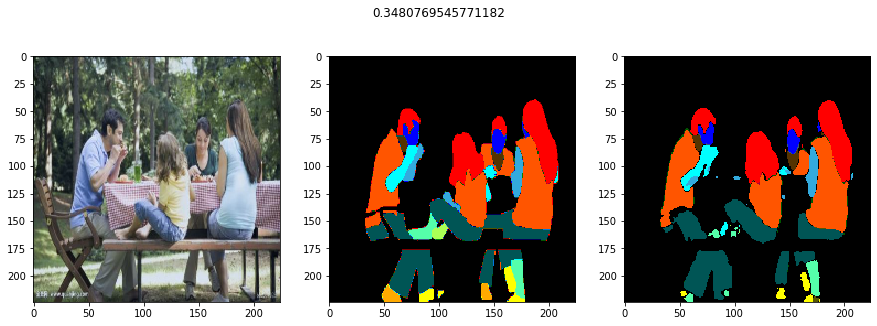

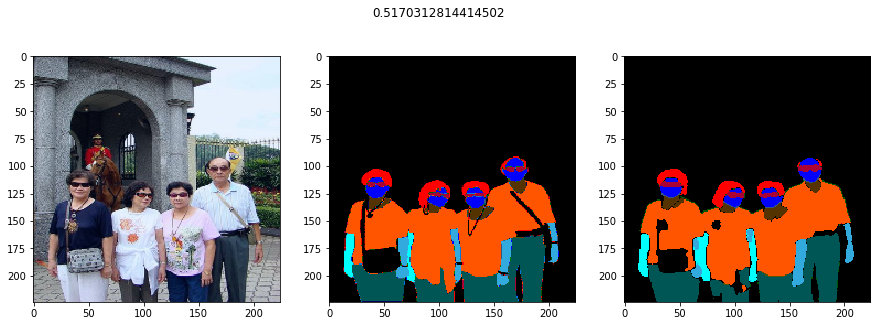

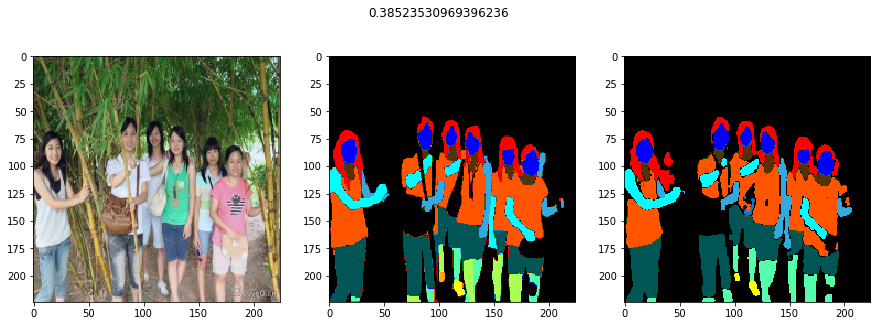

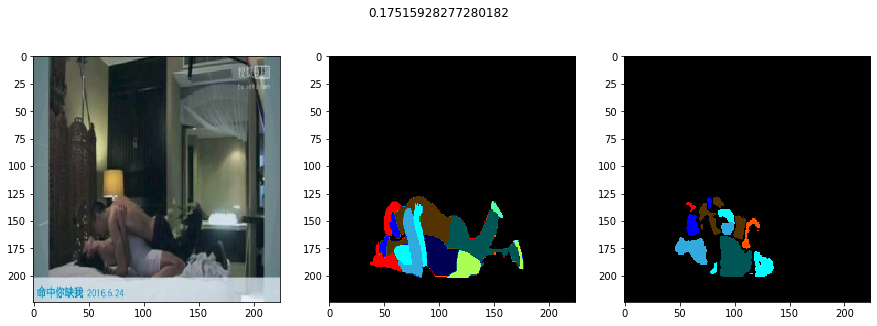

In [61]:
for i in range(BATCH_SIZE):
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    axes = ax.flat
    axes[0].imshow(preview_image(val_xs[i]))
    parse_actual = merge_masks_vis(val_ys[i], num_classes, color_map)
    axes[1].imshow(parse_actual)
    parse_predicted = merge_masks_vis(prediction[i], num_classes, color_map)
    axes[2].imshow(parse_predicted)
    miou, iou = mean_iou(val_ys[i], prediction[i])
    plt.suptitle(miou)

## Inference

In [5]:
import segmentation_models as sm
from keras.utils import to_categorical

import cv2
import numpy as np
import scipy.io
import matplotlib.pyplot as plt

In [2]:
root_path = '.'
checkpoints_path = f'{root_path}/checkpoints'
images_path = f'{root_path}/../dataset/test/models'

In [3]:
def preprocess_image(image, preprocess_input):
    return get_preprocessing(preprocess_input)(image=image)

def extract_masks(image, model, preprocess_input):
    
    image_r = cv2.resize(image, (224,224))
    image_r = np.expand_dims(preprocess_image(image_r, preprocess_input)['image'], axis=0)

    masks = np.squeeze(model.predict(image_r))
    masks = cv2.resize(masks, (image.shape[1], image.shape[0]))
    mask = np.argmax(masks, axis=2)
    
    return to_categorical(mask)

def merge_masks(masks, num_classes):
    res = np.zeros((masks.shape[0], masks.shape[1], num_classes), dtype=np.uint8)
    for c in range(num_classes):
        res[:,:,c] = c*masks[:,:,c]
    return np.sum(res, axis=-1)

def merge_masks_vis(masks, num_classes, color_map):
    res = np.zeros((masks.shape[0], masks.shape[1], 3), dtype=np.uint8)

    for r in range(masks.shape[0]):
        for c in range(masks.shape[1]):
            color_id = np.argmax(masks[r,c,:])
            res[r, c, :] = color_map[color_id]
            
    return res.astype(np.uint8)

In [6]:
mat = scipy.io.loadmat(f'{root_path}/human_colormap.mat')
color_map = (mat['colormap'] * 256).astype(np.int32)

color_classes_map = {
    0: 'Background',
    1: 'Hat',
    2: 'Hair',
    3: 'Glove',
    4: 'Sunglasses',
    5: 'UpperClothes',
    6: 'Dress',
    7: 'Coat',
    8: 'Socks',
    9: 'Pants',
    10: 'Torso-skin',
    11: 'Scarf',
    12: 'Skirt',
    13: 'Face',
    14: 'Left-arm ',
    15: 'Right-arm',
    16: 'Left-leg',
    17: 'Right-leg',
    18: 'Left-shoe',
    19: 'Right-shoe',
}

In [11]:
BACKBONE = 'resnet50'
preprocess_input = sm.get_preprocessing(BACKBONE)

num_classes = 20

weights_name = '202006241823_0.001_resnet50_loss_val_weights.hdf5'
model = sm.Unet(BACKBONE, input_shape=(224, 224, 3), classes=num_classes, activation='softmax', encoder_weights='imagenet')
model.load_weights(f'{checkpoints_path}/{weights_name}')

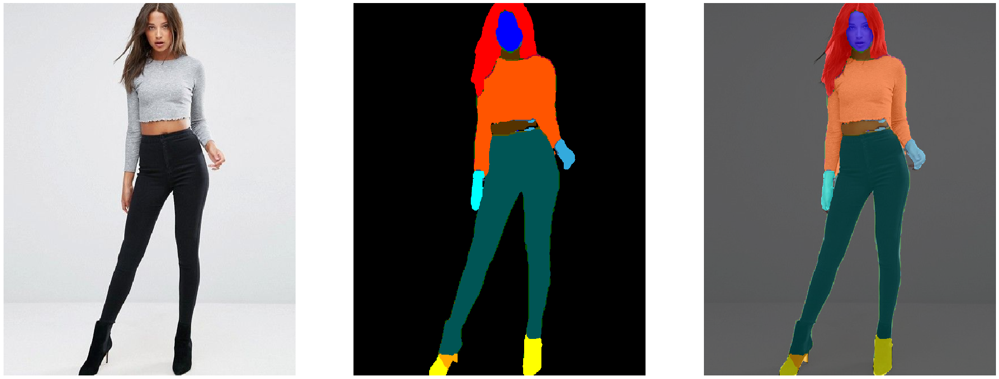

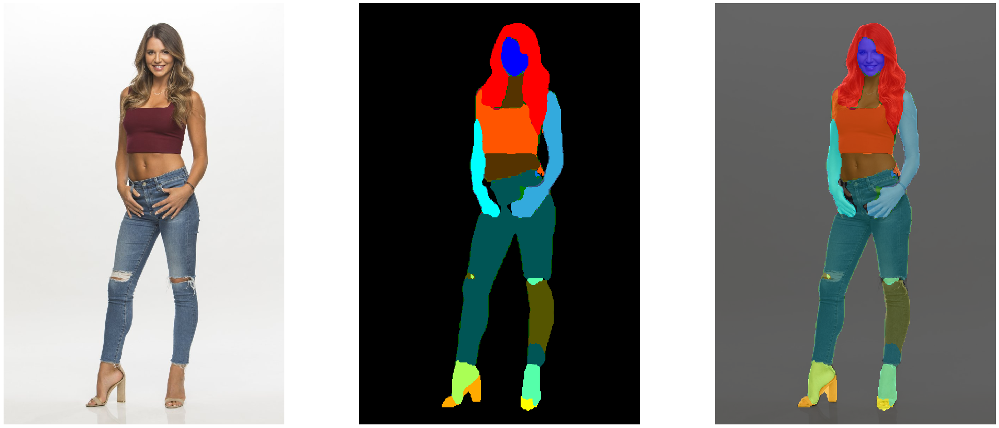

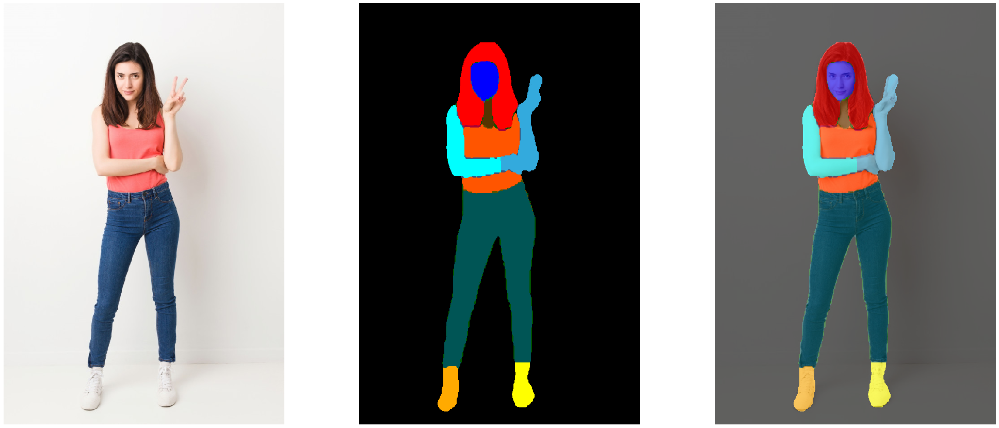

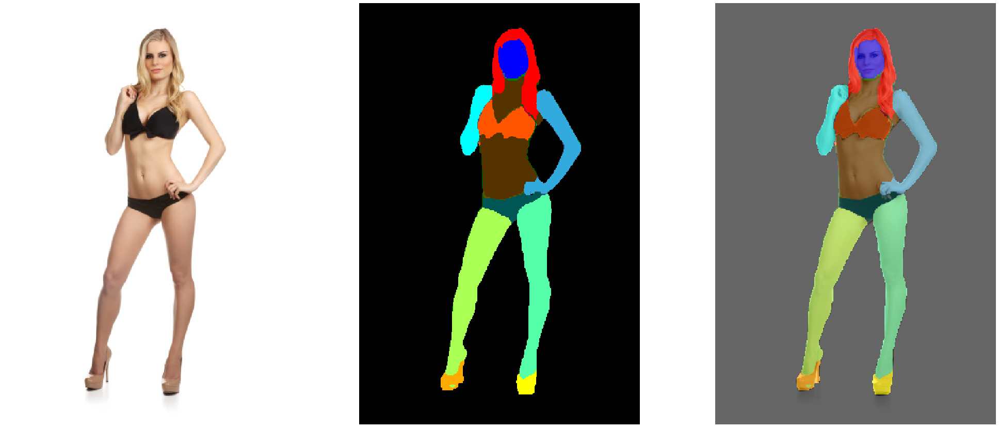

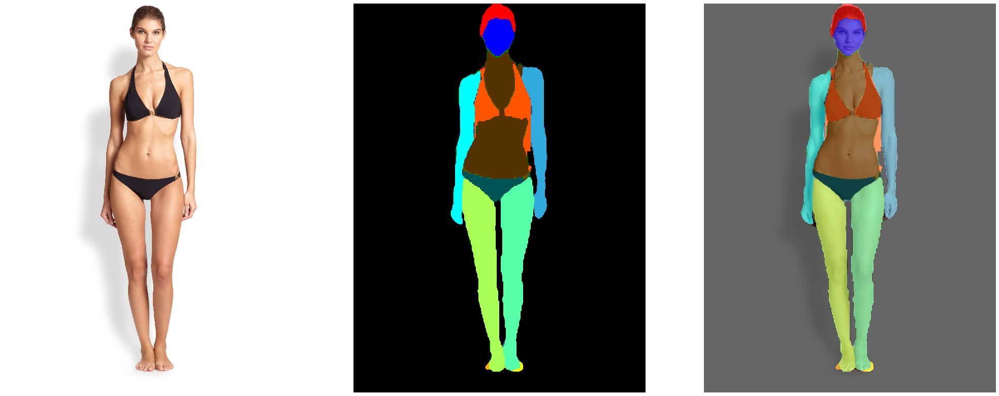

...

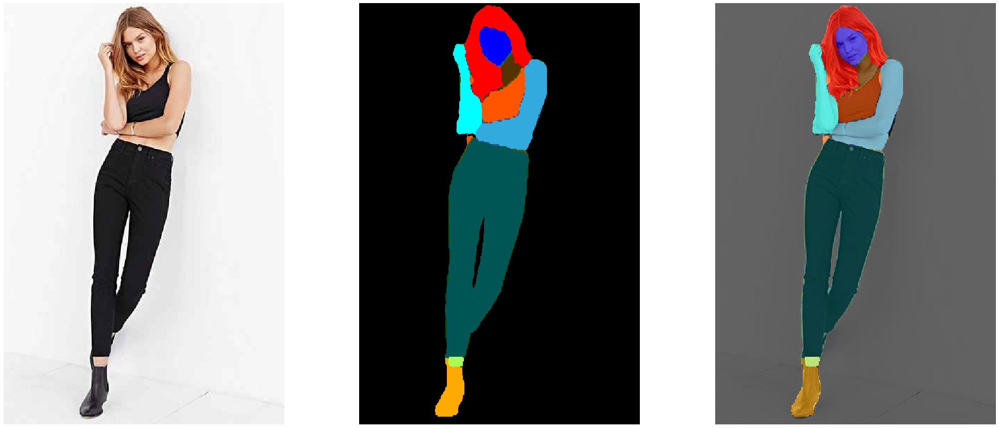

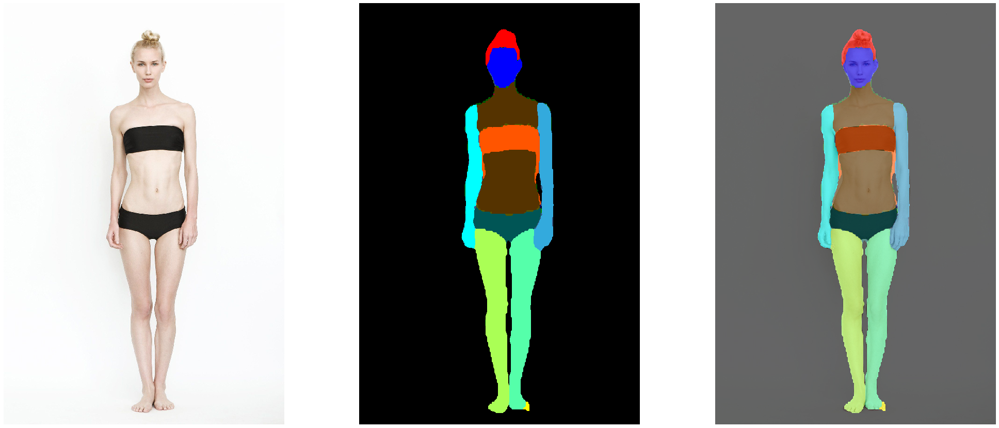

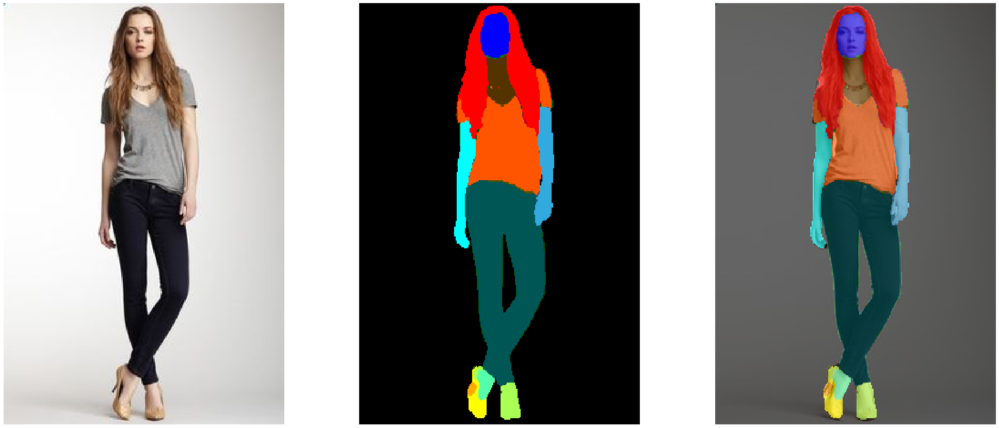

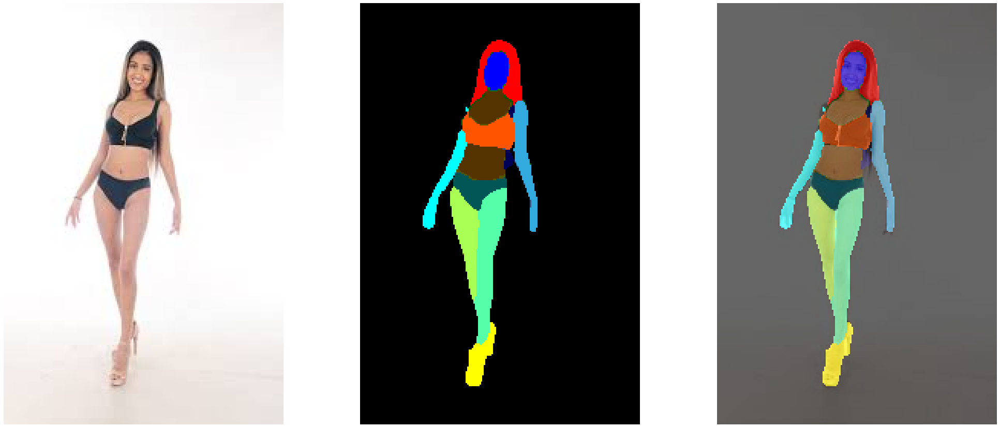

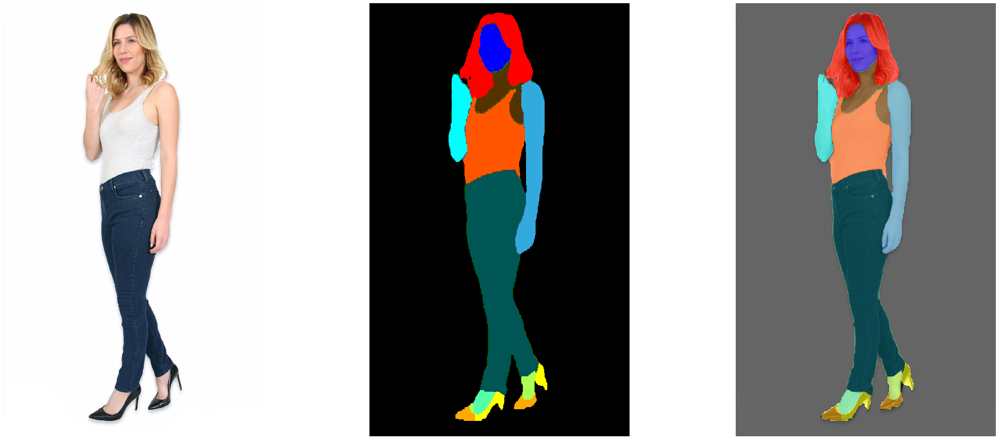

In [17]:
for image_name in os.listdir(images_path):
    fig, ax = plt.subplots(1, 3, figsize=(35,15))
    [axi.set_axis_off() for axi in ax]
    
    image = cv2.cvtColor(cv2.imread(f'{images_path}/{image_name}'), cv2.COLOR_BGR2RGB)
    masks = extract_masks(image, model, preprocess_input)
    masks_vis = merge_masks_vis(masks, num_classes, color_map)
    
    combined = image*0.4 + masks_vis*0.6
    combined = combined.astype(np.uint8)
    
    ax[0].imshow(image)
    ax[1].imshow(masks_vis)
    ax[2].imshow(combined)

## Visual compare with JPPNet 

In [18]:
viton_dataset_path = '../dataset/viton_resize/test'
viton_images_path = f'{viton_dataset_path}/image'
viton_parse_path = f'{viton_dataset_path}/image-parse'

result_path = f'../dataset/test/compare'

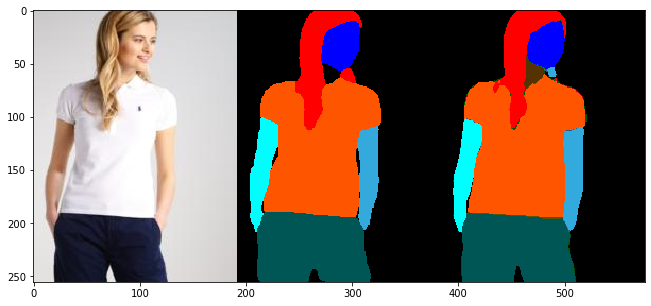

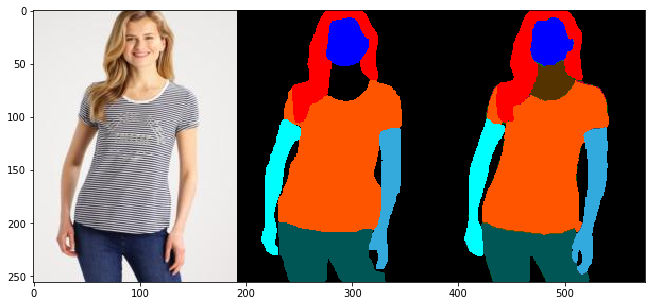

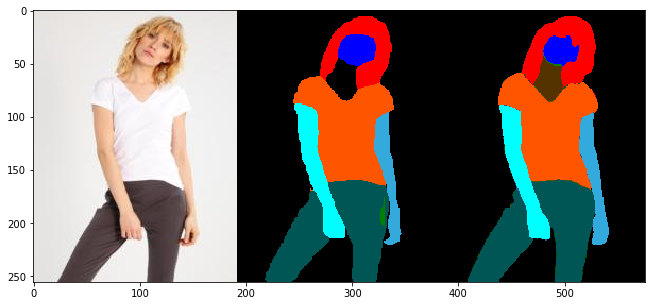

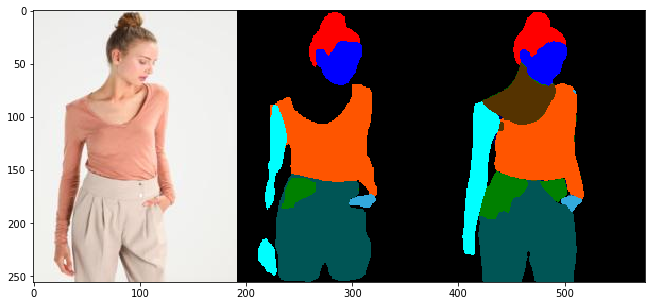

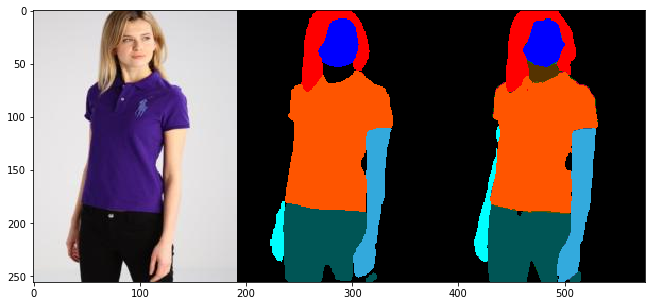

...

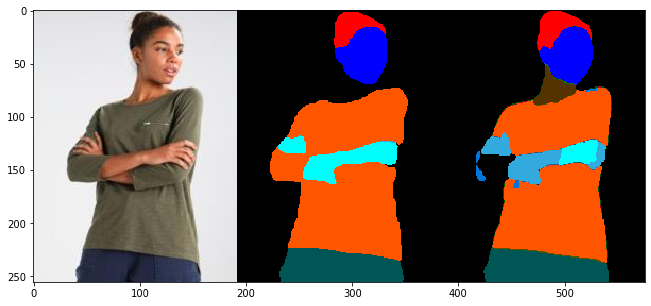

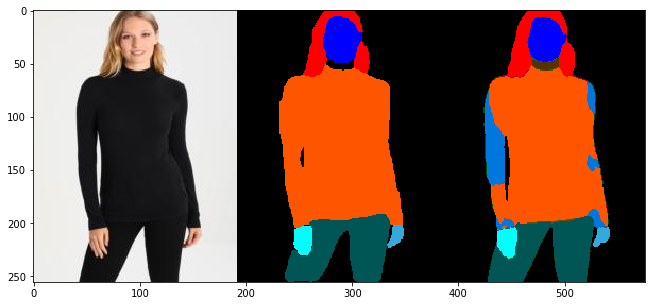

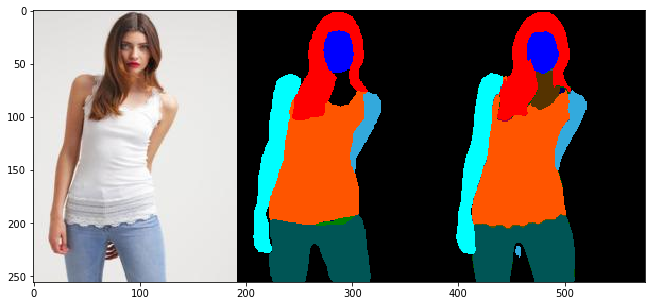

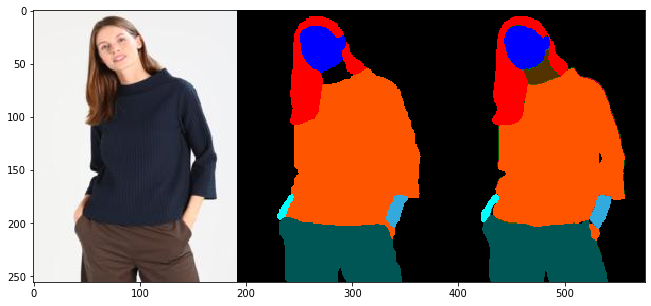

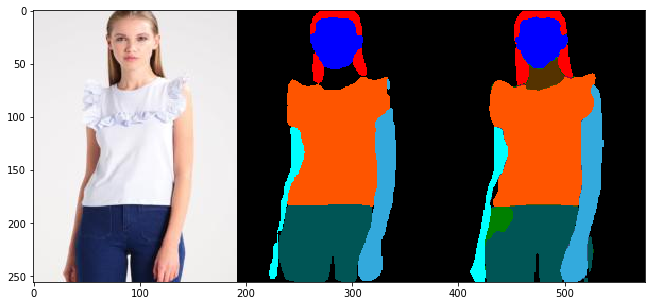

In [20]:
for image_name in os.listdir(viton_images_path)[:20]:
    image_basename = image_name[:-4]
    image = cv2.cvtColor(cv2.imread(f'{viton_images_path}/{image_name}'), cv2.COLOR_BGR2RGB)
    masks = extract_masks(image, model, preprocess_input)
    masks_vis = merge_masks_vis(masks, num_classes, color_map)
    jpp_parse = cv2.cvtColor(cv2.imread(f'{viton_parse_path}/{image_basename}.png'), cv2.COLOR_BGR2RGB)
    
    image_result = np.concatenate((image, jpp_parse, masks_vis), axis=1)
#     cv2.imwrite(f'{result_path}/{image_basename}.png', cv2.cvtColor(image_result, cv2.COLOR_RGB2BGR))
    
    fig, ax = plt.subplots(1,1, figsize=(15,5))
    ax.imshow(image_result)

## Datatset from client

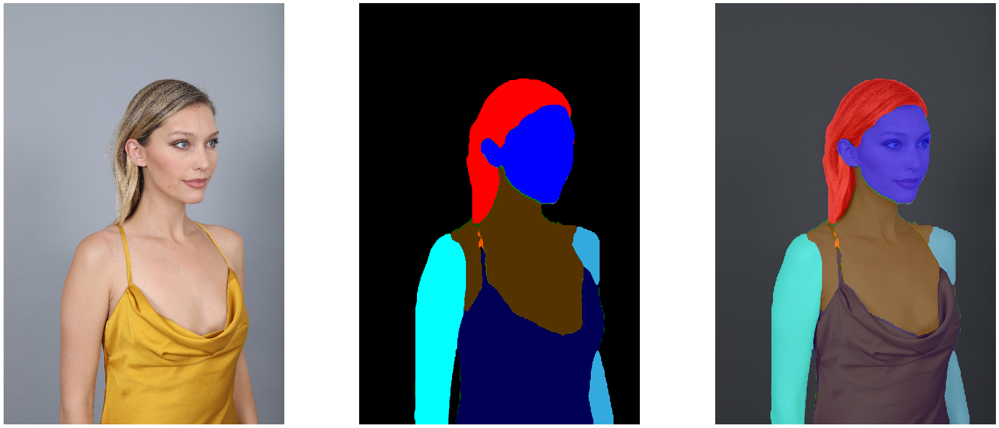

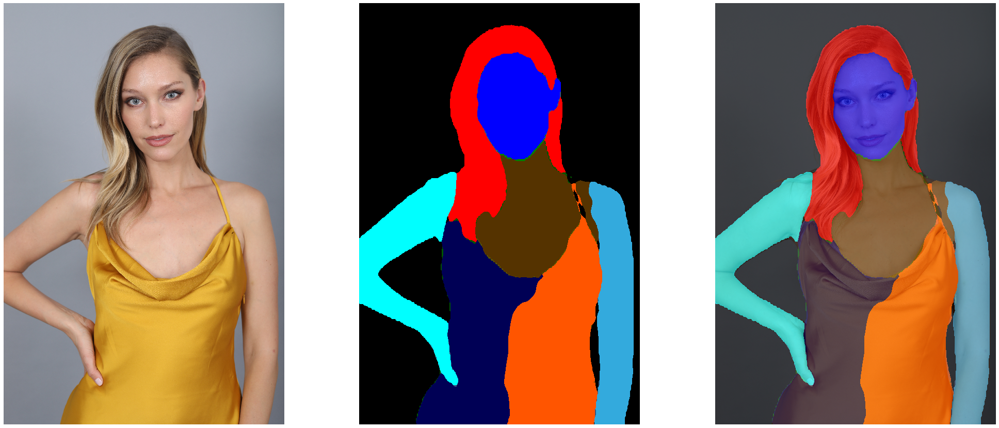

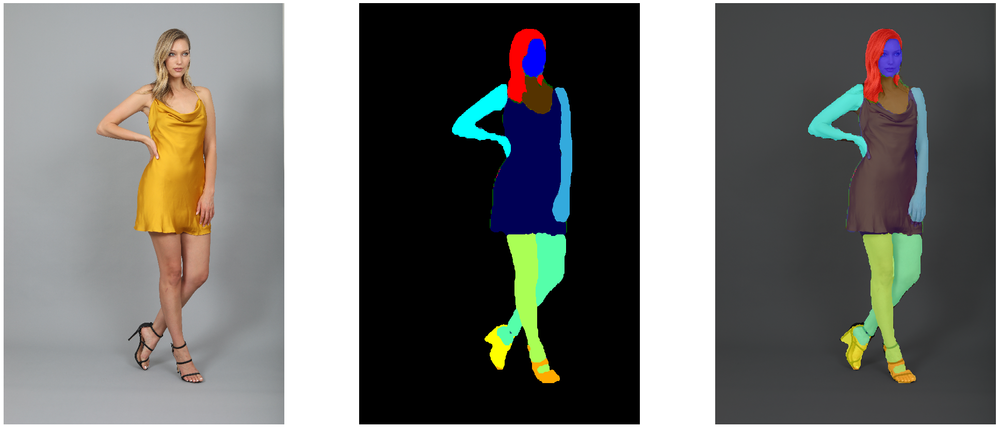

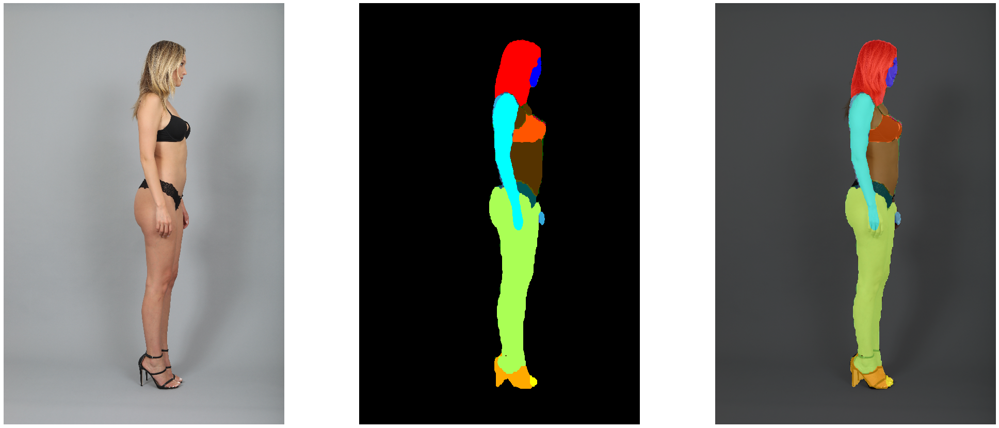

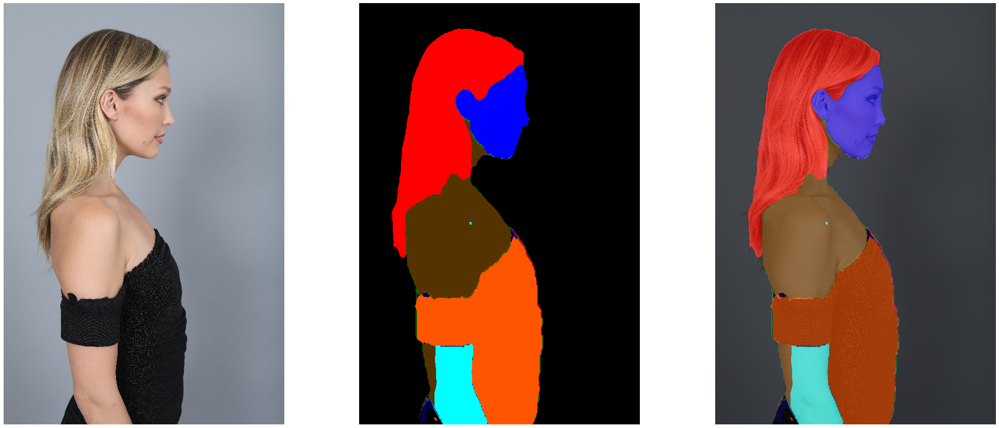

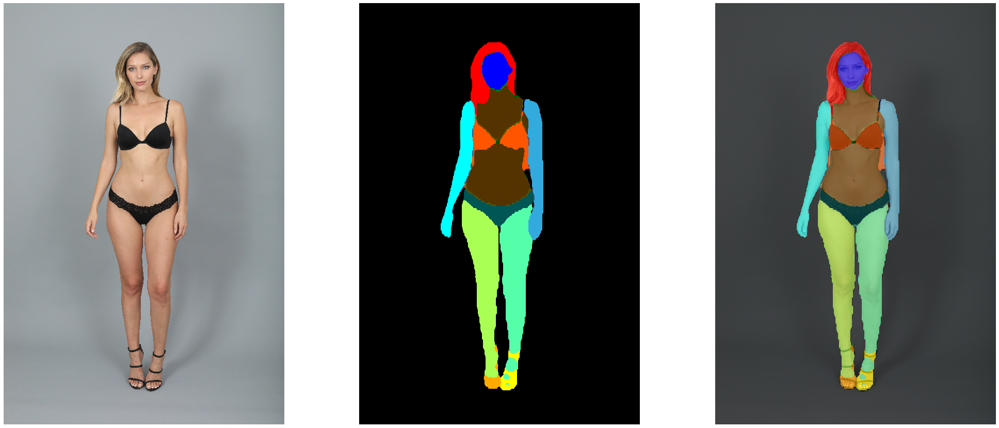

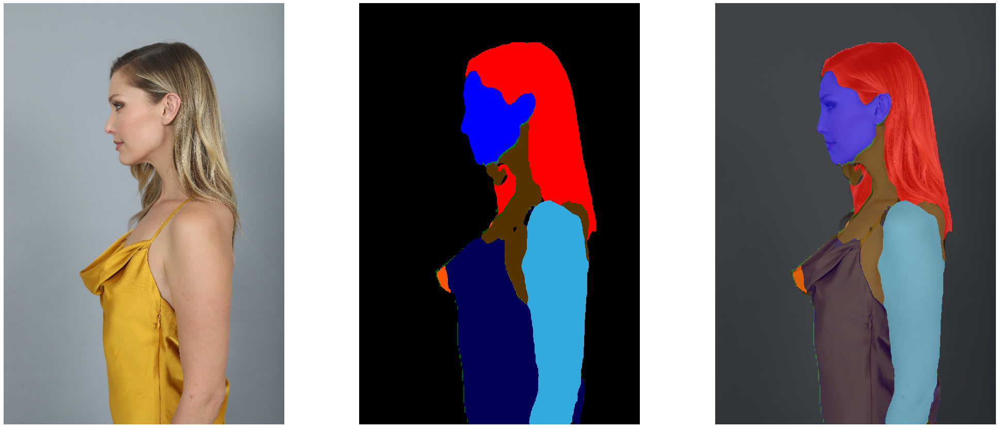

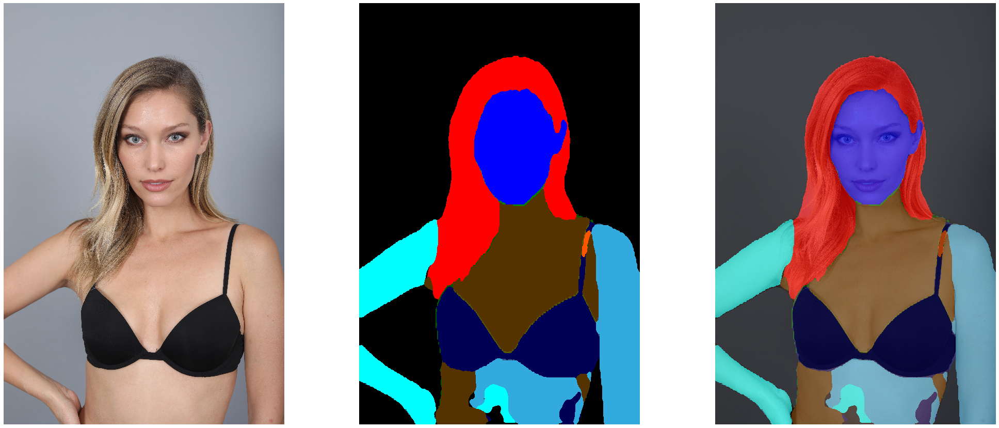

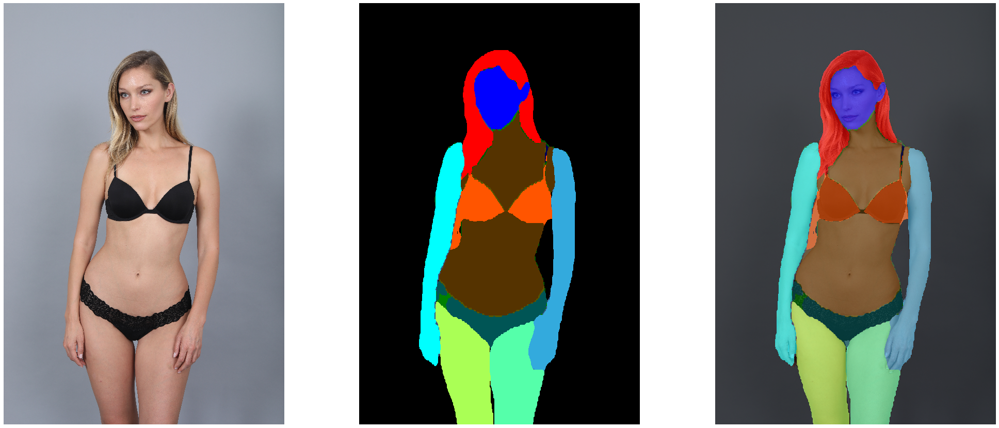

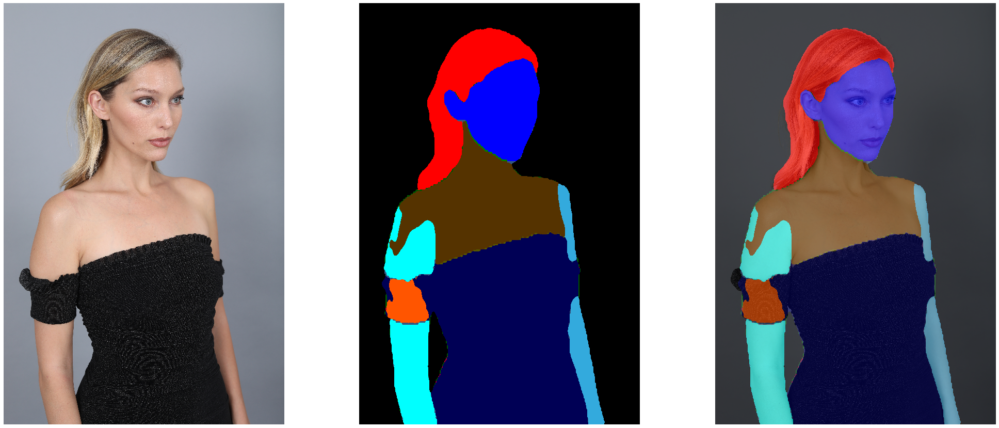

In [22]:
superba_dataset_path = f'/work/develop/viton/dataset/superba'
for image_name in os.listdir(superba_dataset_path)[:10]:
    fig, ax = plt.subplots(1, 3, figsize=(35,15))
    [axi.set_axis_off() for axi in ax]
    
    image = cv2.cvtColor(cv2.imread(f'{superba_dataset_path}/{image_name}'), cv2.COLOR_BGR2RGB)
    masks = extract_masks(image, model, preprocess_input)
    masks_vis = merge_masks_vis(masks, num_classes, color_map)
    
    combined = image*0.4 + masks_vis*0.6
    combined = combined.astype(np.uint8)
    
    ax[0].imshow(image)
    ax[1].imshow(masks_vis)
    ax[2].imshow(combined)

In [24]:
resized_superba_path = '/work/develop/viton/LIP_JPPNet/datasets/examples/images'
jppnet_parsed_path = '/work/develop/viton/LIP_JPPNet/output/parsing/val'

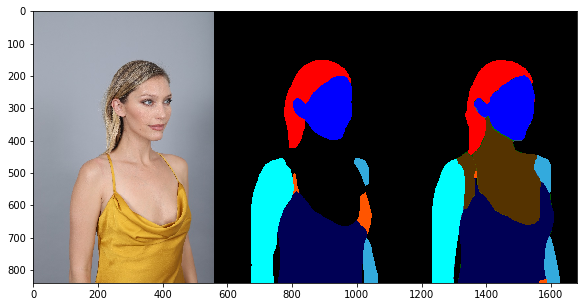

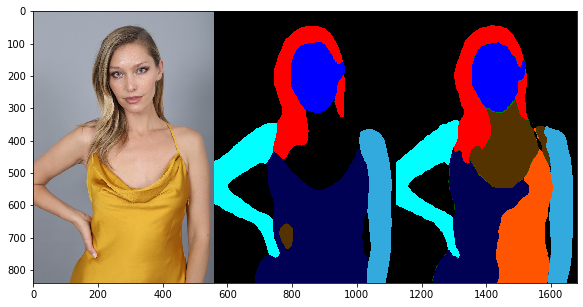

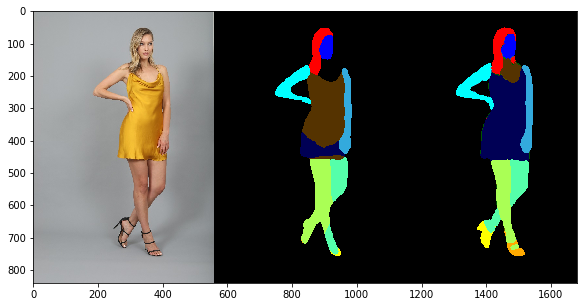

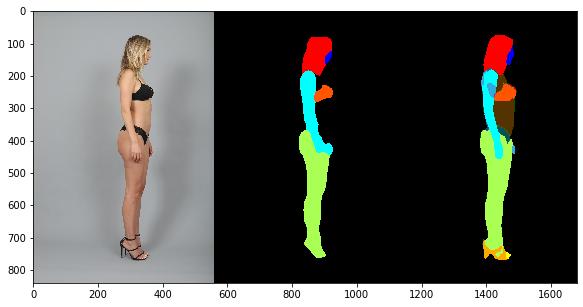

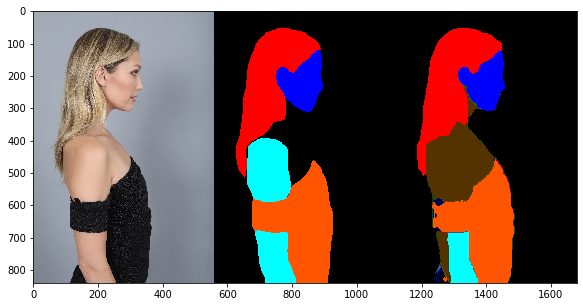

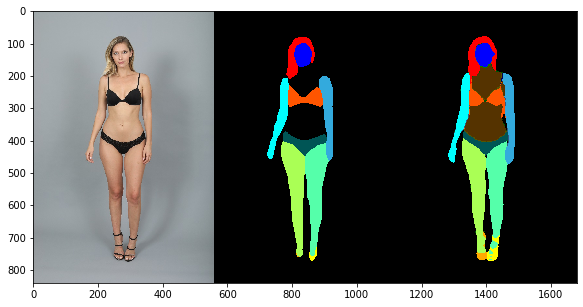

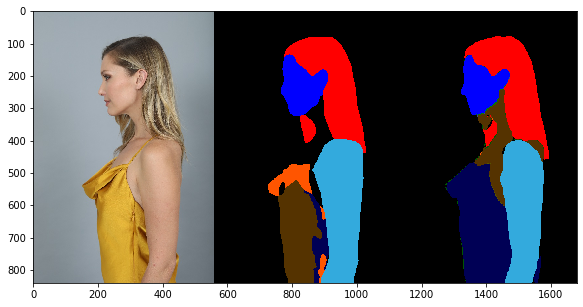

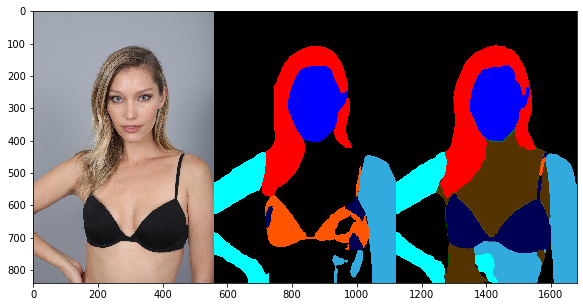

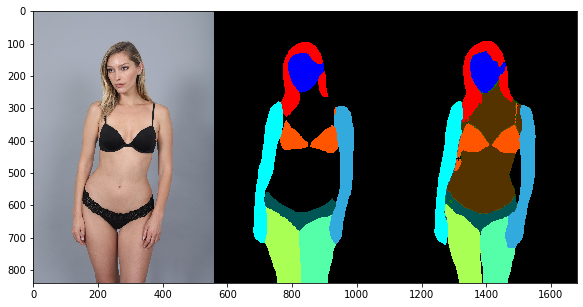

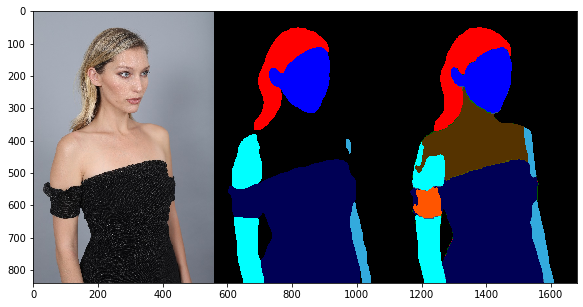

In [26]:
for image_name in os.listdir(resized_superba_path)[:10]:
    image_basename = image_name[:-4]
    image = cv2.cvtColor(cv2.imread(f'{resized_superba_path}/{image_name}'), cv2.COLOR_BGR2RGB)
    masks = extract_masks(image, model, preprocess_input)
    masks_vis = merge_masks_vis(masks, num_classes, color_map)
    jpp_parse = cv2.cvtColor(cv2.imread(f'{jppnet_parsed_path}/{image_basename}_vis.png'), cv2.COLOR_BGR2RGB)
    
    image_result = np.concatenate((image, jpp_parse, masks_vis), axis=1)
    
    fig, ax = plt.subplots(1,1, figsize=(15,5))
    ax.imshow(image_result)